In [ ]:
# For Google Colab hosted runtime
!pip uninstall opencv-python

Cannot uninstall requirement opencv-python, not installed


In [ ]:
# For local runtime
!pip3 install scikit-build

    100% |████████████████████████████████| 81kB 1.6MB/s 
  Using cached https://files.pythonhosted.org/packages/05/8e/8de486cbd03baba4deef4142bd643a3e7bbe954a784dc1bb17142572d127/packaging-21.3-py3-none-any.whl
  Using cached https://files.pythonhosted.org/packages/b0/3a/88b210db68e56854d0bcf4b38e165e03be377e13907746f825790f3df5bf/setuptools-59.6.0-py3-none-any.whl
  Using cached https://files.pythonhosted.org/packages/a0/34/895006117f6fce0b4de045c87e154ee4a20c68ec0a4c9a36d900888fb6bc/pyparsing-3.0.6-py3-none-any.whl


In [ ]:
!pip3 install -U git+https://github.com/albu/albumentations --no-cache-dir

  Cloning https://github.com/albu/albumentations to /tmp/pip-6xh75_30-build
    100% |████████████████████████████████| 13.4MB 4.7MB/s 
    100% |████████████████████████████████| 25.9MB 6.0MB/s 
    100% |████████████████████████████████| 12.4MB 6.4MB/s 
    100% |████████████████████████████████| 604kB 4.4MB/s 
    100% |████████████████████████████████| 89.9MB 160.8MB/s 
    100% |████████████████████████████████| 11.5MB 3.8MB/s 
    100% |████████████████████████████████| 1.6MB 5.4MB/s 
    100% |████████████████████████████████| 4.4MB 4.1MB/s 
    100% |████████████████████████████████| 3.3MB 4.0MB/s 
    100% |████████████████████████████████| 49.4MB 5.6MB/s 
    100% |████████████████████████████████| 153kB 6.9MB/s 
    100% |████████████████████████████████| 20.0MB 3.6MB/s 
    100% |████████████████████████████████| 1.1MB 3.6MB/s 
    100% |████████████████████████████████| 102kB 3.7MB/s 
    100% |████████████████████████████████| 256kB 5.6MB/s 
    100% |████████████████████

In [ ]:
%matplotlib inline

In [ ]:
# run on hosted runtime
from google.colab import drive
drive.mount('/content/drive')

ModuleNotFoundError: ignored

In [ ]:
# For local runtime
!pip3 install --pre torch torchvision torchaudio -f https://download.pytorch.org/whl/nightly/cu113/torch_nightly.html

In [ ]:
# ======================
# Import Libs
# ======================

import os
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader
from torch.utils.data import Dataset as BaseDataset
from torchvision.datasets.vision import VisionDataset
from torchvision import transforms
import pathlib
from copy import deepcopy
import cv2
import albumentations as albu
import matplotlib.pyplot as plt
import time
import copy

In [ ]:
# ======================
# Path
# ======================

# For hosted runtime
# data_dir = '/content/drive/My Drive/RS21/Assignment2/data/'
# model_dir = '/content/drive/My Drive/RS21/Assignment2/UNet/'
# pred_dir = '/content/drive/My Drive/RS21/Assignment2/result/unet/'

# For local runtime
data_dir = "/home/nicholaus-utokyo/Nicholaus' Master Varsity Stuffs/Courses/A1/Remote Sensing Image Analysis/Report2/data/"
model_dir = "/home/nicholaus-utokyo/Nicholaus' Master Varsity Stuffs/Courses/A1/Remote Sensing Image Analysis/Report2/model/"
pred_dir = "/home/nicholaus-utokyo/Nicholaus' Master Varsity Stuffs/Courses/A1/Remote Sensing Image Analysis/Report2/result/unet/"

x_train_dir = os.path.join(data_dir, 'train_img')
y_train_dir = os.path.join(data_dir, 'train_label')

x_val_dir = os.path.join(data_dir, 'val_img')
y_val_dir = os.path.join(data_dir, 'val_label')

In [ ]:
a = os.listdir(model_dir)
a

['unet-dice-5-400eps',
 'unet-tversky-0505-250eps',
 'unet-dice-250eps',
 'unet-bcedice-250eps',
 'unet_E250_B8.pth',
 'unet-tversky-0604-250eps',
 'unet-iou-250eps',
 'unet-bcelogits-250eps']

In [ ]:
# ======================
# Config
# ======================

batch_size = 8
epochs = 250
img_size = 256
in_ch = 3 # number of input channels (RGB)
out_ch = 1 # number of output channels (1 for binary classification)
model_name = 'unet'
model_file = "%s_E%d_B%d.pth"%(model_name, epochs, batch_size)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [ ]:
# ======================
# Custom dataset
# ======================

# https://github.com/qubvel/segmentation_models.pytorch

class RS21BD(VisionDataset):
    CLASSES = [
        "nonbuilding",
        "building",
    ]

    def __init__(
        self,
        images_dir,
        masks_dir,
        classes=None,
        augmentation=None,
    ):
        self.images_dir = images_dir
        self.masks_dir = masks_dir
        self.rgb_list = self._get_rgb_list()

        # convert str names to class values on masks
        self.class_values = [self.CLASSES.index(cls.lower()) for cls in classes]

        self.augmentation = augmentation

    def _get_rgb_list(self):
        return list(sorted(pathlib.Path(self.images_dir).glob("*.png")))

    def __len__(self):
        return len(self.rgb_list)

    def __getitem__(self, index):
        rgb_path = self.rgb_list[index]
        rgb_fname = rgb_path.stem
        cls_path = os.path.join(self.masks_dir, rgb_fname + '.png')

        #image = imread(str(rgb_path))
        image = cv2.imread(str(rgb_path), cv2.IMREAD_COLOR)

        #mask = imread(str(cls_path))
        mask = cv2.imread(str(cls_path), cv2.IMREAD_UNCHANGED)
        mask[mask < 255] = 0  # non-buildings
        mask[mask == 255] = 1  # buildings
        mask = mask.astype('int64')

        # extract certain classes from mask (e.g. building)
        masks = [(mask == v) for v in self.class_values]
        mask = np.stack(masks, axis=-1).astype('int64')

        # apply augmentations
        if self.augmentation:
            sample = self.augmentation(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']

        return image, mask, str(rgb_path)

In [ ]:
# ======================
# Augmentation
# ======================

# https://github.com/albumentations-team/albumentations

def to_tensor(x, **kwargs):
    return x.transpose(2, 0, 1).astype('float32')

def to_tensor_labels(x, **kwargs):
    return x.transpose(2, 0, 1).astype('int64')

def get_training_augmentation():
    train_transform = [
        albu.HorizontalFlip(p=0.5),
        albu.VerticalFlip(p=0.5),
        albu.RandomRotate90(p=0.5),
        albu.Transpose(p=0.5),
        albu.Resize(img_size,img_size),
        albu.Lambda(image=to_tensor,mask=to_tensor),
    ]
    return albu.Compose(train_transform)

def get_val_augmentation():
    test_transform = [
        albu.Resize(img_size,img_size),
        albu.Lambda(image=to_tensor,mask=to_tensor),
    ]
    return albu.Compose(test_transform)

In [ ]:
# ======================
# Model
# ======================

# from https://github.com/gbaier/sat_img_synth/blob/master/models/unet.py

class UNet(nn.Module):
    def __init__(self, in_channels, n_classes, n_downsample=4):
        """
        Implementation of
        U-Net: Convolutional Networks for Biomedical Image Segmentation
        (Ronneberger et al., 2015)
        https://arxiv.org/abs/1505.04597
        Args:
            in_channels (int): number of input channels
            n_classes (int): number of output channels
            n_downsample (int): depth of the network
        """
        super().__init__()

        # input and output channels for the downsampling path
        out_channels = [64 * (2 ** i) for i in range(n_downsample)]
        in_channels = [in_channels] + out_channels[:-1]

        self.down_path = nn.ModuleList(
            [self._make_unet_conv_block(ich, och) for ich, och in zip(in_channels, out_channels)]
        )

        # input channels of the upsampling path
        in_channels = [64 * (2 ** i) for i in range(n_downsample, 0, -1)]
        self.body = self._make_unet_conv_block(out_channels[-1], in_channels[0])

        self.upsamplers = nn.ModuleList(
            [self._make_upsampler(nch, nch // 2) for nch in in_channels]
        )

        self.up_path = nn.ModuleList(
            [self._make_unet_conv_block(nch, nch // 2) for nch in in_channels]
        )

        self.last = nn.Conv2d(64, n_classes, kernel_size=1)

        self._return_intermed = False

    @staticmethod
    def _make_unet_conv_block(in_channels, out_channels):
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.ReLU(),
        )

    @property
    def return_intermed(self):
        return self._return_intermed

    @return_intermed.setter
    def return_intermed(self, value):
        self._return_intermed = value

    def _make_upsampler(self, in_channels, out_channels):
        return nn.ConvTranspose2d(in_channels, out_channels, kernel_size=2, stride=2)

    def forward(self, x):
        blocks = []
        for down in self.down_path:
            # UNet conv block increases the number of channels
            x = down(x)
            blocks.append(x)
            # Downsampling, by mass pooling
            x = F.max_pool2d(x, 2)

        x = self.body(x)

        for upsampler, up, block in zip(self.upsamplers, self.up_path, reversed(blocks)):
            # upsample and reduce number of channels
            x = upsampler(x)
            x = torch.cat([x, block], dim=1)
            # UNet conv block reduces the number of channels again
            x = up(x)

        x = self.last(x)

        if self.return_intermed:
            return x, blocks

        return x

In [ ]:
# ======================
# Function for training a model
# ======================

# modified from https://pytorch.org/tutorials/beginner/transfer_learning_tutorial.html

def train_model(model, criterion, optimizer, loader, n_epochs=25):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    train_accs = []
    val_accs = []

    for epoch in range(1, n_epochs + 1):
        print('Epoch {}/{}'.format(epoch, n_epochs))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data.
            for x, y, f in loader[phase]:

                img_in = x.to(device).float()
                img_out = y.to(device).float()

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    output = model.forward(img_in)
                    loss = criterion(output, img_out)
                    pred = (output > 0.5).long()

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * img_in.size(0)
                running_corrects += torch.sum(pred == img_out)

            epoch_loss = running_loss / len(loader[phase].dataset)

            if phase == 'train':
                epoch_acc = running_corrects.double() / (len(loader[phase].dataset) * img_size * img_size)
                train_accs.append(epoch_acc)
            else:
                epoch_acc = running_corrects.double() / (len(loader[phase].dataset) * img_size * img_size)
                val_accs.append(epoch_acc)

            print('{} Loss: {:.4f} Acc: {:.4f}'.format(
                phase, epoch_loss, epoch_acc))
            
            # deep copy the model
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())
                # save model
                torch.save(model, model_dir+model_file)
                print('Model saved!')


    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))
    print('Best val Acc: {:4f}'.format(best_acc))

    plt.plot(np.array(train_accs), 'r')
    plt.plot(np.array(val_accs), 'b')
    plt.show()

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model

In [ ]:
# ======================
# Dataset
# ======================

CLASSES =  ["building"]

train_dataset = RS21BD(
    x_train_dir,
    y_train_dir,
    augmentation=get_training_augmentation(),
    classes=CLASSES,
    )

val_dataset = RS21BD(
    x_val_dir,
    y_val_dir,
    augmentation=get_val_augmentation(),
    classes=CLASSES,
    )

dataloaders = {'train': DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=1),
              'val': DataLoader(val_dataset, batch_size=1, shuffle=False, num_workers=1)}

# Custom Loss Functions
Code reference: https://www.kaggle.com/bigironsphere/loss-function-library-keras-pytorc


## Dice Loss

In [ ]:
class DiceLoss(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(DiceLoss, self).__init__()

    def forward(self, inputs, targets, smooth=1):
        
        #comment out if your model contains a sigmoid or equivalent activation layer
        inputs = F.sigmoid(inputs)      
        
        #flatten label and prediction tensors
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        
        intersection = (inputs * targets).sum()                            
        dice = (2.*intersection + smooth)/(inputs.sum() + targets.sum() + smooth)  
        
        return 1 - dice

## BCE-Dice Loss

In [ ]:
class DiceBCELoss(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(DiceBCELoss, self).__init__()

    def forward(self, inputs, targets, smooth=1):
        
        #comment out if your model contains a sigmoid or equivalent activation layer
        inputs = F.sigmoid(inputs)       
        
        #flatten label and prediction tensors
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        
        intersection = (inputs * targets).sum()                            
        dice_loss = 1 - (2.*intersection + smooth)/(inputs.sum() + targets.sum() + smooth)  
        BCE = F.binary_cross_entropy(inputs, targets, reduction='mean')
        Dice_BCE = BCE + dice_loss
        
        return Dice_BCE

## Jaccard Intersection Over Union (IoU Loss)

In [ ]:
class IoULoss(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(IoULoss, self).__init__()

    def forward(self, inputs, targets, smooth=1):
        
        #comment out if your model contains a sigmoid or equivalent activation layer
        inputs = F.sigmoid(inputs)       
        
        #flatten label and prediction tensors
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        
        #intersection is equivalent to True Positive count
        #union is the mutually inclusive area of all labels & predictions 
        intersection = (inputs * targets).sum()
        total = (inputs + targets).sum()
        union = total - intersection 
        
        IoU = (intersection + smooth)/(union + smooth)
                
        return 1 - IoU

## Focal Loss

In [ ]:
ALPHA = 0.8
GAMMA = 2

class FocalLoss(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(FocalLoss, self).__init__()

    def forward(self, inputs, targets, alpha=ALPHA, gamma=GAMMA, smooth=1):
        
        #comment out if your model contains a sigmoid or equivalent activation layer
        inputs = F.sigmoid(inputs)       
        
        #flatten label and prediction tensors
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        
        #first compute binary cross-entropy 
        BCE = F.binary_cross_entropy(inputs, targets, reduction='mean')
        BCE_EXP = torch.exp(-BCE)
        focal_loss = alpha * (1-BCE_EXP)**gamma * BCE
                       
        return focal_loss

## Tversky Loss

In [ ]:
ALPHA = 0.6
BETA = 0.4

class TverskyLoss(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(TverskyLoss, self).__init__()

    def forward(self, inputs, targets, smooth=1, alpha=ALPHA, beta=BETA):
        
        #comment out if your model contains a sigmoid or equivalent activation layer
        inputs = F.sigmoid(inputs)       
        
        #flatten label and prediction tensors
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        
        #True Positives, False Positives & False Negatives
        TP = (inputs * targets).sum()    
        FP = ((1-targets) * inputs).sum()
        FN = (targets * (1-inputs)).sum()
       
        Tversky = (TP + smooth) / (TP + alpha*FP + beta*FN + smooth)  
        
        return 1 - Tversky

Epoch 1/250
----------


/home/nicholaus-utokyo/.local/lib/python3.6/site-packages/torch/nn/functional.py:1916: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


train Loss: 0.6973 Acc: 0.5843
val Loss: 0.7503 Acc: 0.7773
Model saved!
Epoch 2/250
----------
train Loss: 0.6028 Acc: 0.7411
val Loss: 0.7200 Acc: 0.6499
Epoch 3/250
----------
train Loss: 0.6143 Acc: 0.7403
val Loss: 0.7336 Acc: 0.5771
Epoch 4/250
----------
train Loss: 0.5965 Acc: 0.7368
val Loss: 0.7070 Acc: 0.7382
Epoch 5/250
----------
train Loss: 0.5765 Acc: 0.7453
val Loss: 0.6859 Acc: 0.7412
Epoch 6/250
----------
train Loss: 0.5810 Acc: 0.7714
val Loss: 0.6893 Acc: 0.7267
Epoch 7/250
----------
train Loss: 0.5916 Acc: 0.7771
val Loss: 0.6824 Acc: 0.7646
Epoch 8/250
----------
train Loss: 0.5939 Acc: 0.7216
val Loss: 0.6762 Acc: 0.7576
Epoch 9/250
----------
train Loss: 0.5704 Acc: 0.7747
val Loss: 0.6587 Acc: 0.7965
Model saved!
Epoch 10/250
----------
train Loss: 0.5809 Acc: 0.7786
val Loss: 0.6364 Acc: 0.7995
Model saved!
Epoch 11/250
----------
train Loss: 0.5736 Acc: 0.7717
val Loss: 0.7012 Acc: 0.6355
Epoch 12/250
----------
train Loss: 0.5591 Acc: 0.7674
val Loss: 0.64

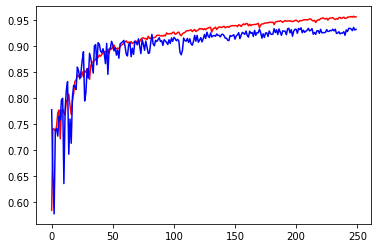

In [ ]:
# ======================
# Model set up & traning
# ======================
train_mode = True

# criterion = torch.nn.BCEWithLogitsLoss()
criterion = DiceLoss() #best result
# criterion = DiceBCELoss()
# criterion = IoULoss()
# criterion = FocalLoss()
# criterion = TverskyLoss()
model = UNet(in_ch, out_ch).to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=0.0001)
#optimizer = torch.optim.SGD(model.parameters(), lr=0.001, momentum=0.9)
if train_mode == True:
  model = train_model(model, criterion, optimizer, dataloaders, epochs)
else:
  # load best saved checkpoint
  model = torch.load(model_dir+model_file)

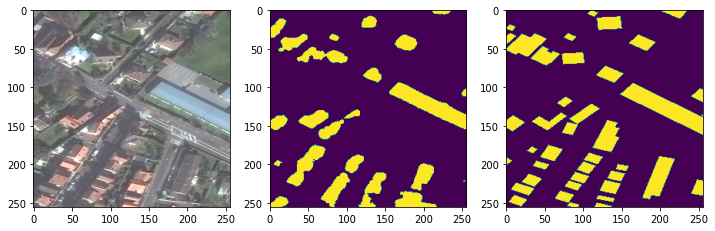

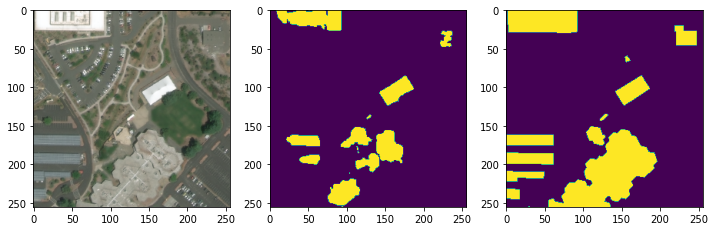

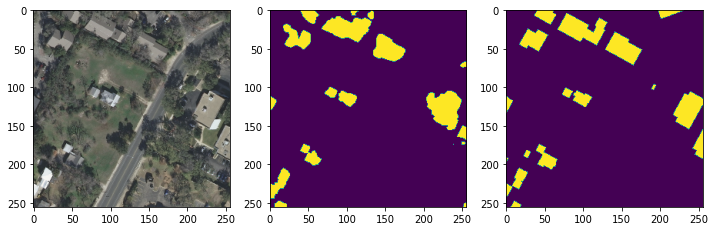

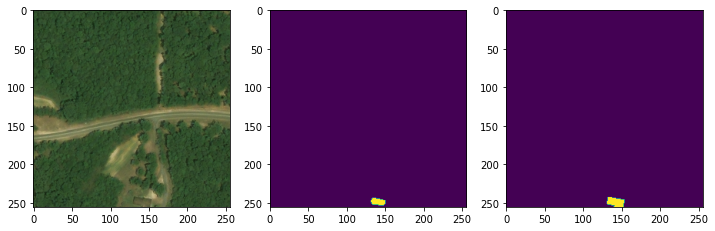

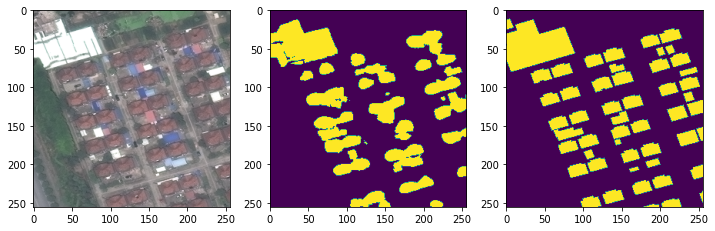

...

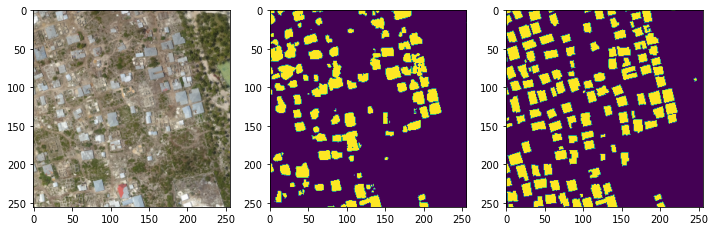

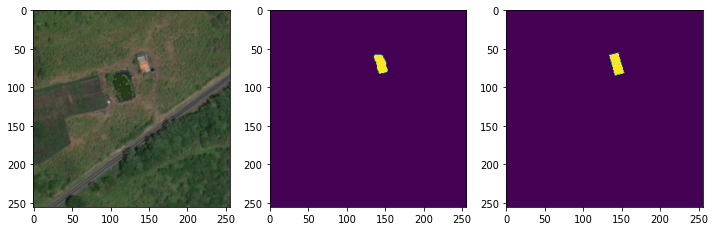

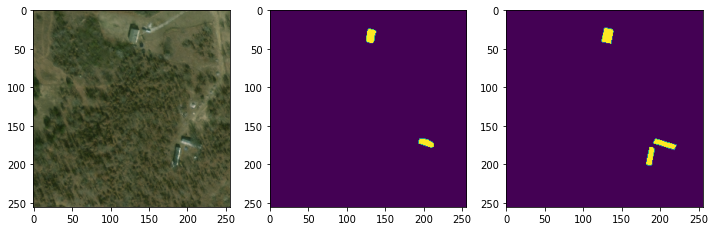

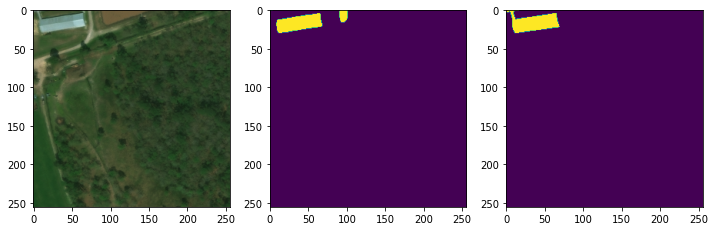

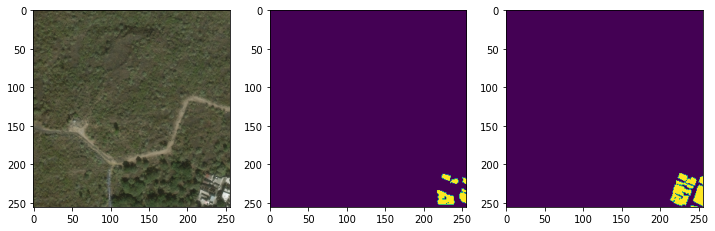

In [ ]:
# ======================
# Visualize results for val set
# ======================

model.eval()

for n in range(len(val_dataset)):
    input, output, rgb_path = val_dataset[n]
    x_tensor = torch.from_numpy(input).to(device).unsqueeze(0)
    output = output.squeeze()

    prediction = model(x_tensor)
    prediction = (prediction > 0).long().squeeze().cpu().numpy().round()

    rgb = input.transpose(1, 2, 0)

    plt.figure(figsize=(12,12))
    plt.subplot(1,3,1)
    plt.imshow(rgb[:,:,[2,1,0]]/255)
    plt.subplot(1,3,2)
    plt.imshow(prediction)
    plt.subplot(1,3,3)
    plt.imshow(output)
    plt.show()

    rgb_fname = pathlib.Path(rgb_path).stem
    prediction = (prediction*255).astype('uint8')
    prediction = cv2.resize(prediction, (512, 512), interpolation=cv2.INTER_CUBIC)
    # save prediction with the original image size
    cv2.imwrite(pred_dir + rgb_fname + '.png', prediction)

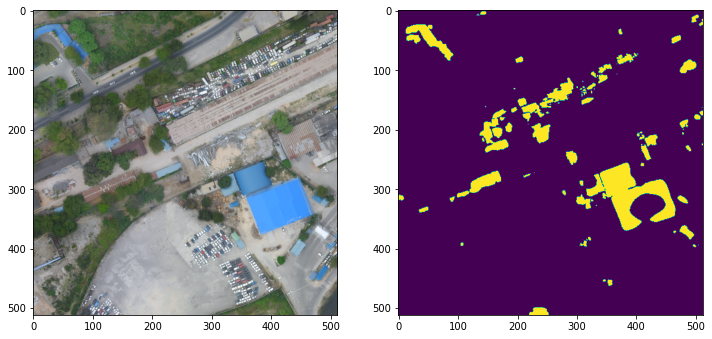

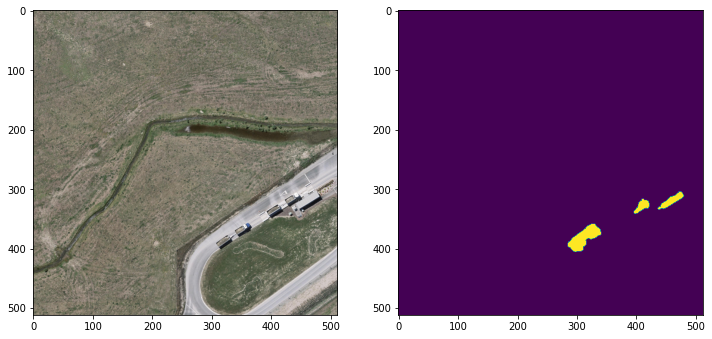

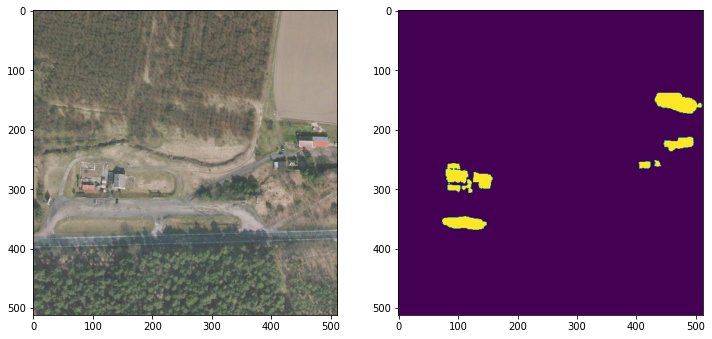

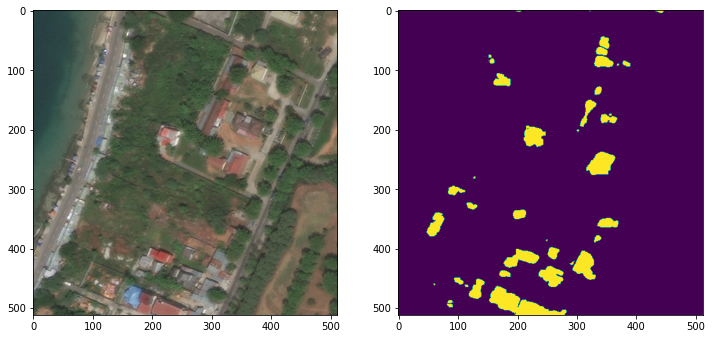

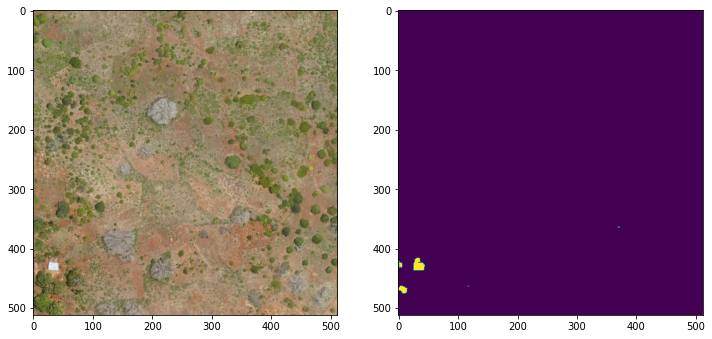

...

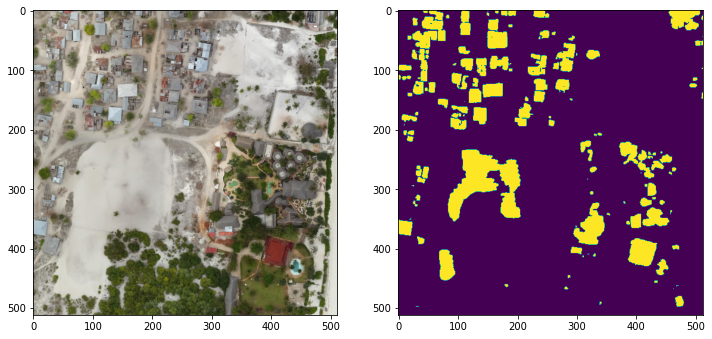

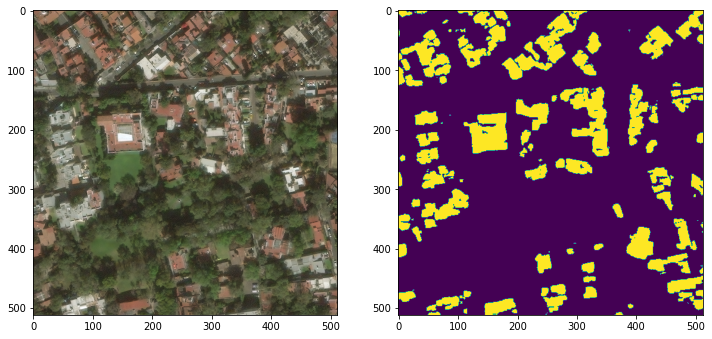

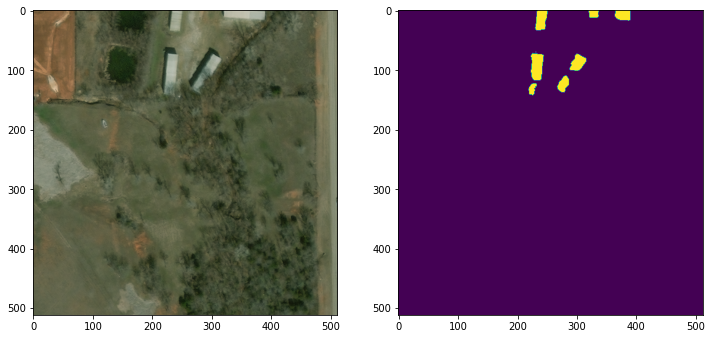

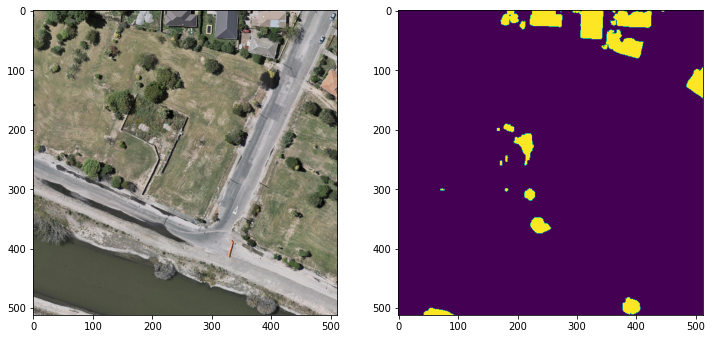

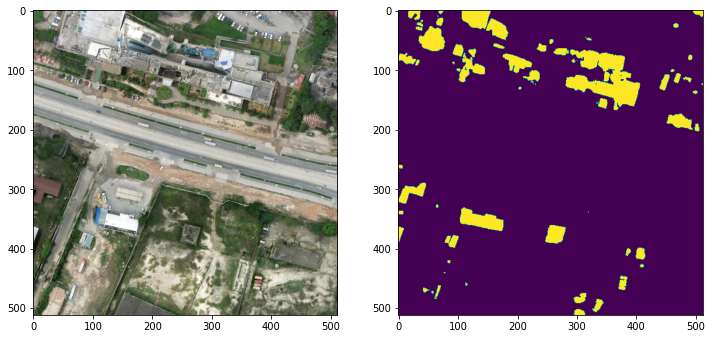

In [ ]:
# ======================
# Visualize results for test set
# ======================
from glob import glob

x_test_dir = os.path.join(data_dir, 'test_img')
test_files = glob(x_test_dir+'/*.png')

model.eval()

for f in test_files:
    image = cv2.imread(f, cv2.IMREAD_COLOR)
    input = image.transpose(2, 0, 1).astype('float32')
    x_tensor = torch.from_numpy(input).to(device).unsqueeze(0)

    prediction = model(x_tensor)
    prediction = (prediction > 0).long().squeeze().cpu().numpy().round()

    rgb = input.transpose(1, 2, 0)

    plt.figure(figsize=(12,12))
    plt.subplot(1,2,1)
    plt.imshow(rgb[:,:,[2,1,0]]/255)
    plt.subplot(1,2,2)
    plt.imshow(prediction)
    plt.show()

    rgb_fname = pathlib.Path(f).stem
    prediction = (prediction*255).astype('uint8')
    prediction = cv2.resize(prediction, (512, 512), interpolation=cv2.INTER_CUBIC)
    # save prediction with the original image size
    cv2.imwrite(pred_dir + rgb_fname + '.png', prediction)